In [1]:
import numpy as np
import cv2
import matplotlib.pyplot as plt
import matplotlib.image as mpimg
import os
import glob

## Helpers

In [251]:
def draw_lines(img, lines, color=[255, 0, 0], thickness=2):
    for line in lines:
        x1,y1,x2,y2 = line
        cv2.line(img, (x1, y1), (x2, y2), color, thickness)

def draw_vertices(img, vertices, color=[255, 0, 0], thickness=2):
    v = np.copy(vertices)
    v = np.concatenate((v, [v[0]]), axis=0)
    lines = [(v[i][0], v[i][1], v[i+1][0], v[i+1][1]) for i in range(len(v)-1)]  
    draw_lines(img, lines, color, thickness)

## Compute the camera calibration matrix and distortion coefficients given a set of chessboard images.

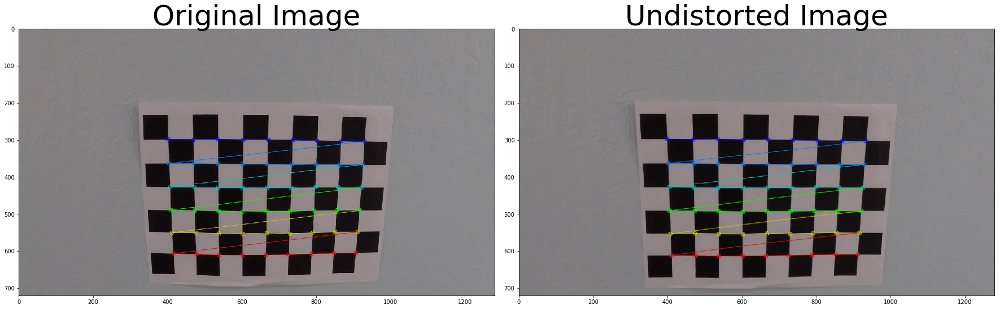

In [2]:
# prepare object points
nx = 9
ny = 6

def getCalibrationPoints(images):
    
    # Arrays to store object points and image points from all the images.
    objpoints = [] # 3d point in real world space
    imgpoints = [] # 2d points in image plane.

    # prepare object points, like (0,0,0), (1,0,0), (2,0,0) ....,(6,5,0)
    objp = np.zeros((nx*ny,3), np.float32)
    objp[:,:2] = np.mgrid[0:nx,0:ny].T.reshape(-1,2)

    for fname in images:

        img = cv2.imread(fname)

        # Convert to grayscale
        gray = cv2.cvtColor(img, cv2.COLOR_BGR2GRAY)

        # Find the chessboard corners
        ret, corners = cv2.findChessboardCorners(gray, (nx, ny), None)

        # If save imgpoints
        if ret == True:
            imgpoints.append(corners)
            objpoints.append(objp)
            
        img_shape = img.shape
            
    return imgpoints, objpoints, img_shape

def getCalibrationMatrixAndDistortionCoefficients(images):
    imgpoints, objpoints, img_shape = getCalibrationPoints(images)
    ret, mtx, dist, rvecs, tvecs = cv2.calibrateCamera(
            objpoints, 
            imgpoints,
            img_shape[1::-1],
            None,
            None
            )
    
    return mtx, dist

# Test
cal_images = glob.glob('camera_cal/*.jpg')
mtx, dist = getCalibrationMatrixAndDistortionCoefficients(cal_images)

# draw corners
img = cv2.imread(cal_images[13])
gray = cv2.cvtColor(img, cv2.COLOR_BGR2GRAY)
ret, corners = cv2.findChessboardCorners(gray, (nx, ny), None)
cv2.drawChessboardCorners(img, (nx, ny), corners, ret)

# undistort
dst = cv2.undistort(img, mtx, dist, None, mtx)

# plot
f, (ax1, ax2) = plt.subplots(1, 2, figsize=(24, 9))
f.tight_layout()
ax1.imshow(img)
ax1.set_title('Original Image', fontsize=50)
ax2.imshow(dst)
ax2.set_title('Undistorted Image', fontsize=50)
plt.subplots_adjust(left=0., right=1, top=0.9, bottom=0.)

## Apply a distortion correction to raw images.
Save corrected images in `output_images` prefixed with `dist_correction_`

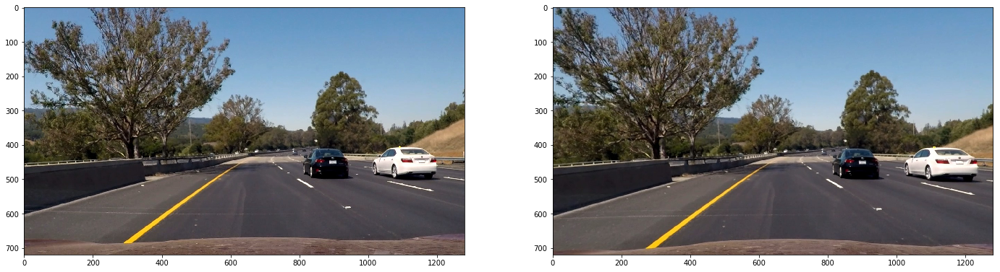

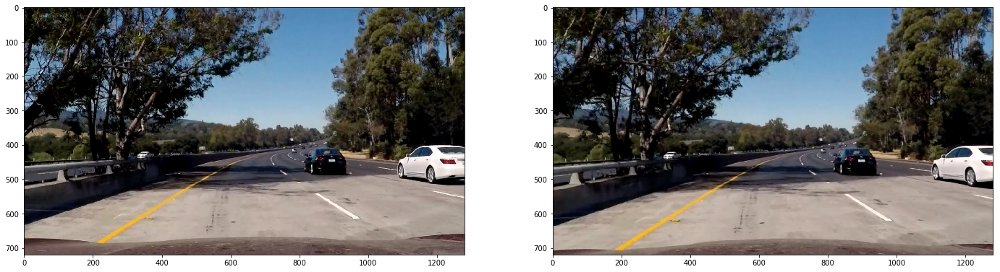

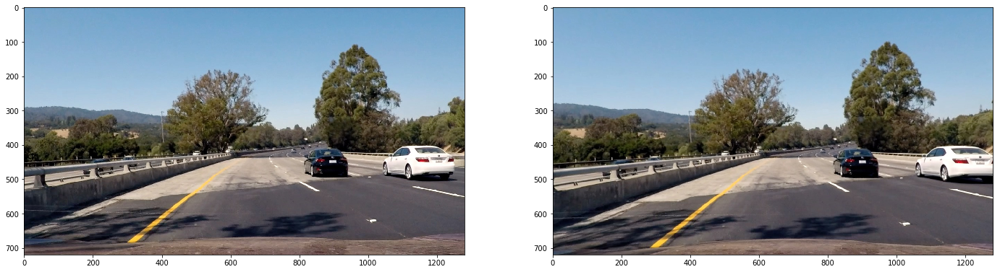

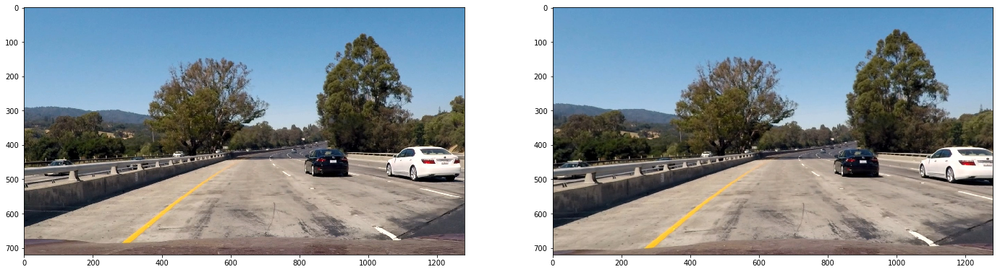

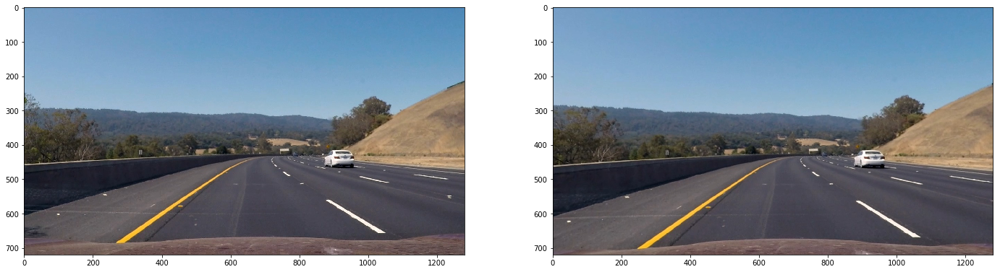

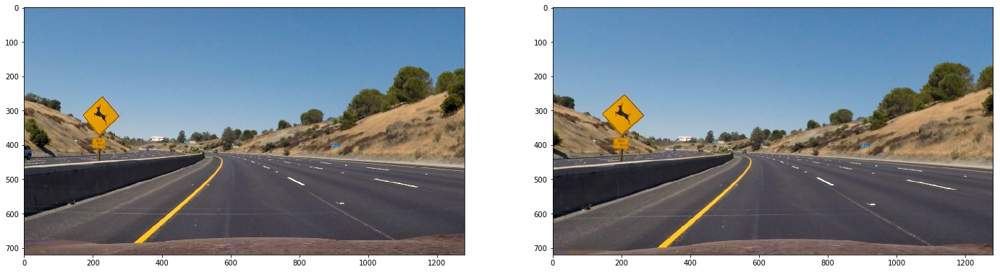

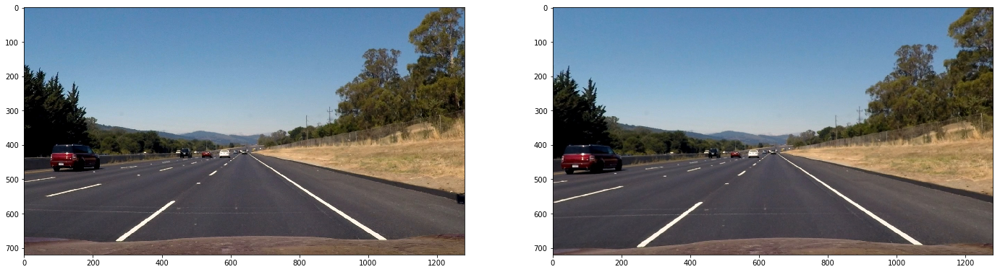

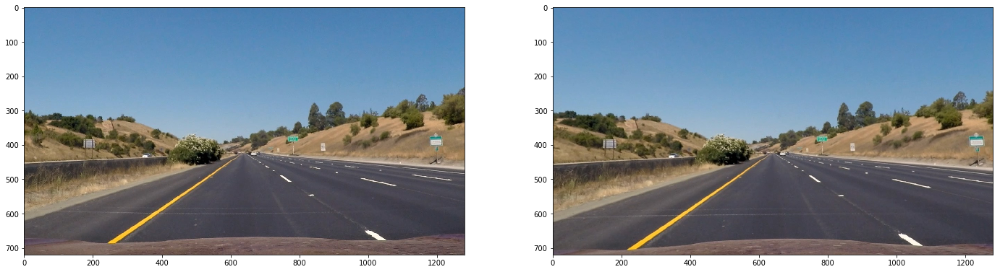

In [136]:
raw_images = os.listdir("test_images/")
no_of_images = len(raw_images)
for i in range(no_of_images):
    img = mpimg.imread("test_images/" + raw_images[i])
    dst = cv2.undistort(img, mtx, dist, None, mtx)
    
    bgr = cv2.cvtColor(dst, cv2.COLOR_RGB2BGR)
    cv2.imwrite('output_images/dist_correction_' + raw_images[i], bgr)
    
    # plot
    fig = plt.figure(figsize=(24, 80))
    fig.tight_layout()
    fig.add_subplot(no_of_images,2,1 + i*2)
    plt.imshow(img)
    fig.add_subplot(no_of_images,2,2 + i*2)
    plt.imshow(dst)

## Use color transforms, gradients, etc., to create a thresholded binary image.

In [205]:

# Define a function that applies Sobel x or y, 
# then takes an absolute value and applies a threshold.
# Note: calling your function with orient='x', thresh_min=5, thresh_max=100
# should produce output like the example image shown above this quiz.
def abs_sobel_thresh(gray, orient='x', sobel_kernel=3, thresh=(0, 255)):
    
    # Apply the following steps to img
    # 2) Take the derivative in x or y given orient = 'x' or 'y'
    if orient == 'x':
        sobel = cv2.Sobel(gray, cv2.CV_64F, 1, 0, ksize=sobel_kernel)
    if orient == 'y':
        sobel = cv2.Sobel(gray, cv2.CV_64F, 0, 1, ksize=sobel_kernel)
    # 3) Take the absolute value of the derivative or gradient
    abs_sobel = np.absolute(sobel)
    # 4) Scale to 8-bit (0 - 255) then convert to type = np.uint8
    scaled_sobel = np.uint8(255*abs_sobel/np.max(abs_sobel))
    # 5) Create a mask of 1's where the scaled gradient magnitude 
            # is > thresh_min and < thresh_max
    binary_output = np.zeros_like(scaled_sobel)
    binary_output[(scaled_sobel >= thresh[0]) & (scaled_sobel <= thresh[1])] = 1
    # 6) Return this mask as your binary_output image
    return binary_output

# Define a function that applies Sobel x and y, 
# then computes the magnitude of the gradient
# and applies a threshold
def mag_threshold(gray, sobel_kernel=3, mag_thresh=(0, 255)):
    
    # Apply the following steps to img
    # 2) Take the gradient in x and y separately
    sobel_x = cv2.Sobel(gray, cv2.CV_64F, 1, 0, ksize=sobel_kernel)
    sobel_y = cv2.Sobel(gray, cv2.CV_64F, 0, 1, ksize=sobel_kernel)
    # 3) Calculate the magnitude 
    abs_sobel= np.sqrt(sobel_x**2 + sobel_y**2)
    # 4) Scale to 8-bit (0 - 255) and convert to type = np.uint8
    scaled_sobel = np.uint8(255*abs_sobel/np.max(abs_sobel))
    # 5) Create a binary mask where mag thresholds are met
    binary_output = np.zeros_like(scaled_sobel)
    binary_output[(scaled_sobel >= mag_thresh[0]) & (scaled_sobel <= mag_thresh[1])] = 1
    # 6) Return this mask as your binary_output image
    return binary_output

# Define a function that applies Sobel x and y, 
# then computes the direction of the gradient
# and applies a threshold.
def dir_threshold(gray, sobel_kernel=3, dir_thresh=(0, np.pi/2)):
    # Apply the following steps to img
    # 2) Take the gradient in x and y separately
    sobel_x = cv2.Sobel(gray, cv2.CV_64F, 1, 0, ksize=sobel_kernel)
    sobel_y = cv2.Sobel(gray, cv2.CV_64F, 0, 1, ksize=sobel_kernel)
    # 3) Take the absolute value of the x and y gradients
    abs_sobelx = np.abs(sobel_x) 
    abs_sobely = np.abs(sobel_y) 
    # 4) Use np.arctan2(abs_sobely, abs_sobelx) to calculate the direction of the gradient 
    direction = np.arctan2(abs_sobely, abs_sobelx)
    # 5) Create a binary mask where direction thresholds are met
    binary_output = np.zeros_like(direction)
    binary_output[(direction >= dir_thresh[0]) & (direction <= dir_thresh[1])] = 1
    # 6) Return this mask as your binary_output image
    return binary_output

def thresholds(gray, kernel=3, thresh=(0, 255)):
    blur = cv2.blur(gray, (kernel, kernel))
    binary = np.zeros_like(blur)
    binary[(blur >= thresh[0]) & (blur <= thresh[1])] = 1
    
    return binary

def region_of_interest(img, vertices):
    """
    Applies an image mask.
    
    Only keeps the region of the image defined by the polygon
    formed from `vertices`. The rest of the image is set to black.
    `vertices` should be a numpy array of integer points.
    """
    #defining a blank mask to start with
    mask = np.zeros_like(img)   
    
    #defining a 3 channel or 1 channel color to fill the mask with depending on the input image
    if len(img.shape) > 2:
        channel_count = img.shape[2]  # i.e. 3 or 4 depending on your image
        ignore_mask_color = (255,) * channel_count
    else:
        ignore_mask_color = 255
        
    #filling pixels inside the polygon defined by "vertices" with the fill color    
    cv2.fillPoly(mask, vertices, ignore_mask_color)
    
    #returning the image only where mask pixels are nonzero
    masked_image = cv2.bitwise_and(img, mask)
    return masked_image
                
def combining_thresholds(img, kernel=3, 
                         x_thresh=(0, 255), 
                         y_thresh=(0, 255), 
                         mag_thresh=(0, 255), 
                         dir_thresh=(0, np.pi/2),
                         s_thresh=(0, 255)
                        ):
    
    # Convert to HLS color space and separate the V channel
    hls = cv2.cvtColor(img, cv2.COLOR_RGB2HLS)
    l_channel = hls[:,:,1]
    s_channel = hls[:,:,2]
    gray = cv2.cvtColor(img, cv2.COLOR_RGB2GRAY)
    
    # Apply each of the thresholding functions
    gradx = abs_sobel_thresh(l_channel, orient='x', sobel_kernel=kernel, thresh=x_thresh)
    grady = abs_sobel_thresh(l_channel, orient='y', sobel_kernel=kernel, thresh=y_thresh)
    #mag_binary = mag_threshold(l_channel, sobel_kernel=kernel, mag_thresh=mag_thresh)
    #dir_binary = dir_threshold(l_channel, sobel_kernel=kernel, dir_thresh=dir_thresh)
    s_binary = thresholds(s_channel, kernel=kernel, thresh=s_thresh)

    combined = np.zeros_like(gradx)
  
    combined[
        ((gradx == 1) & (grady == 1)) | 
        #((mag_binary == 1) & (dir_binary == 1)) |
        s_binary == 1
    ] = 1

    #combined = np.dstack((s_binary, (mag_binary == 1) & (dir_binary == 1), (gradx == 1) & (grady == 1))) * 255

    return combined

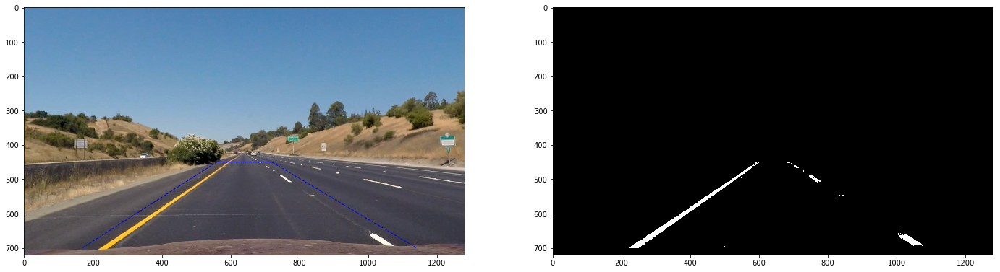

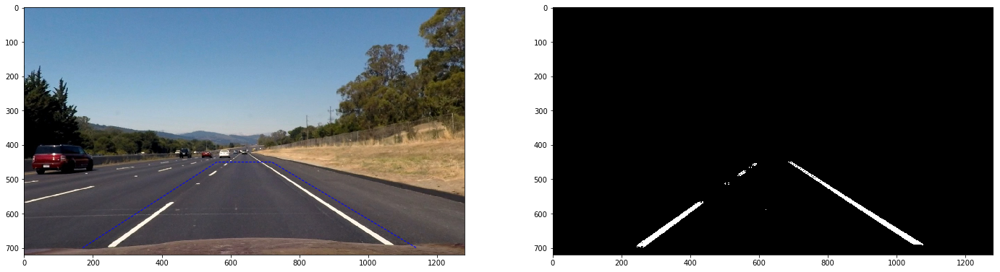

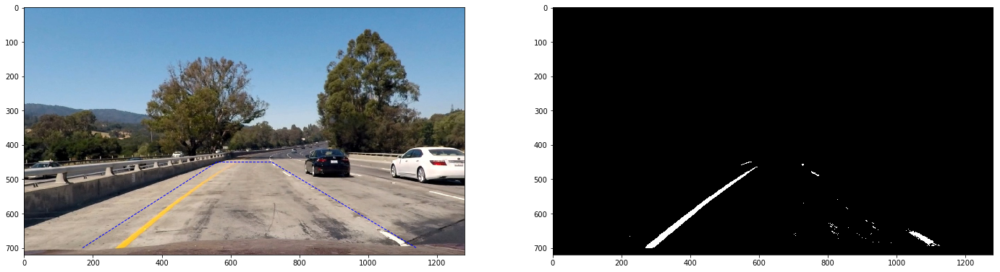

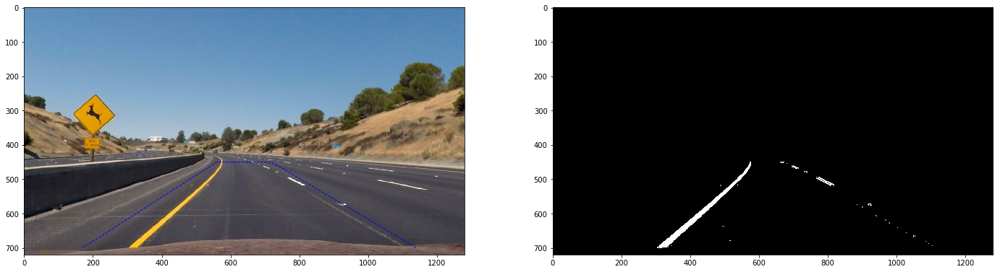

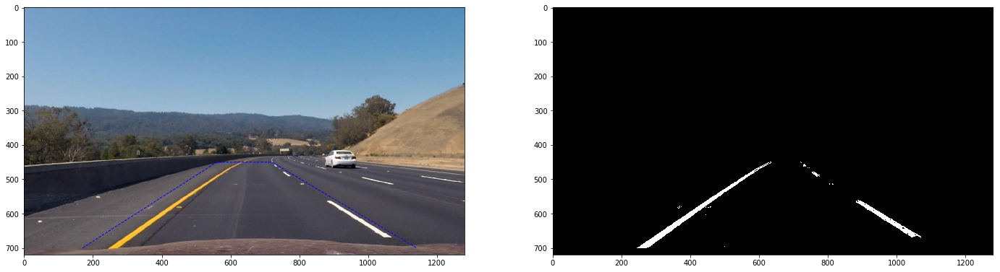

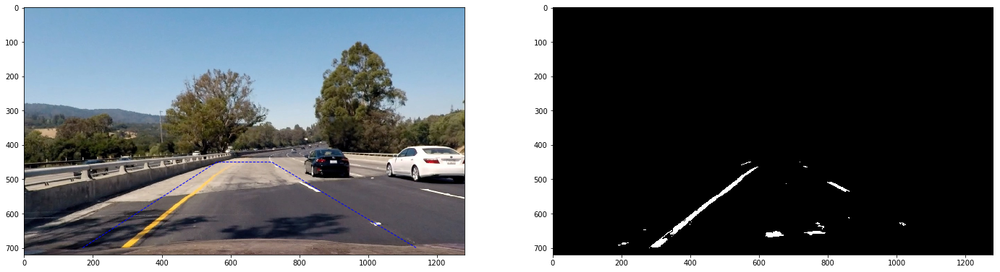

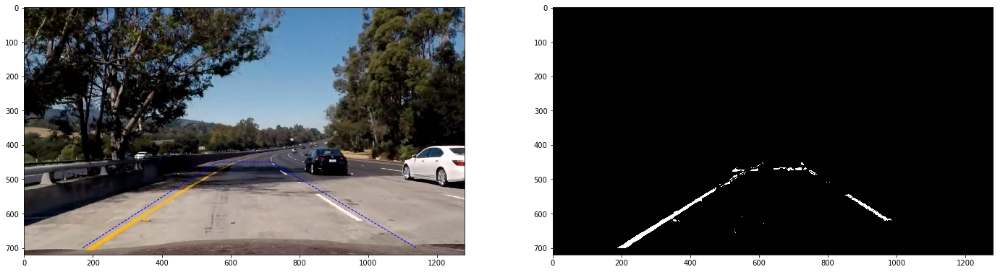

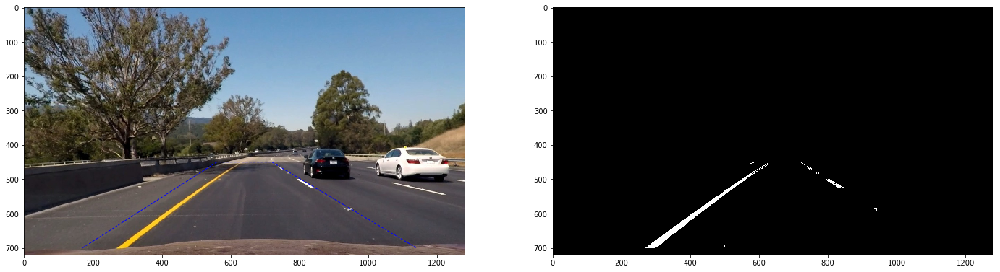

In [206]:
cor_images = glob.glob('output_images/dist_correction_*.jpg')
cor_images.sort()
no_of_images = len(cor_images)

def getVerticesRoi(img):
    # roi
    top_roi = 450
    top_width_roi = 160
    left_roi = 170
    right_roi = 140
    bottom_roi = 20

    image_size = img.shape[1::-1]
    return np.array([[
            (left_roi, image_size[1]-bottom_roi),
            (image_size[0]/2-top_width_roi/2, top_roi), 
            (image_size[0]/2+top_width_roi/2, top_roi), 
            (image_size[0]-right_roi, image_size[1]-bottom_roi)
        ]], dtype=np.int32)
  
img = mpimg.imread(cor_images[0])
vertices_roi = getVerticesRoi(img)

for i in range(no_of_images):
#for i in [0]:
    img = mpimg.imread(cor_images[i])
        
    dst = combining_thresholds(
        img, 
        kernel=5, 
        x_thresh=(30, 255),
        y_thresh=(30, 255),
        mag_thresh=(50, 255),
        dir_thresh=(0.1, 1.4),
        s_thresh=(140, 255)
    )
    
    dst = region_of_interest(dst, vertices_roi)

    color_binary = np.dstack((dst, dst, dst)) * 255
    fname = cor_images[i].replace('dist_correction_', 'binary_');
    cv2.imwrite(fname, color_binary)
    
    # plot
    fig = plt.figure(figsize=(24, 80))
    fig.tight_layout()
    fig.add_subplot(no_of_images,2,1)
    x = vertices_roi[:,:,0].flatten()
    y = vertices_roi[:,:,1].flatten()
    plt.plot(x, y, 'b--', lw=1)
    plt.imshow(img)
    fig.add_subplot(no_of_images,2,2)
    plt.imshow(dst, cmap='gray')
    #plt.imshow(dst)



## Apply a perspective transform to rectify binary image

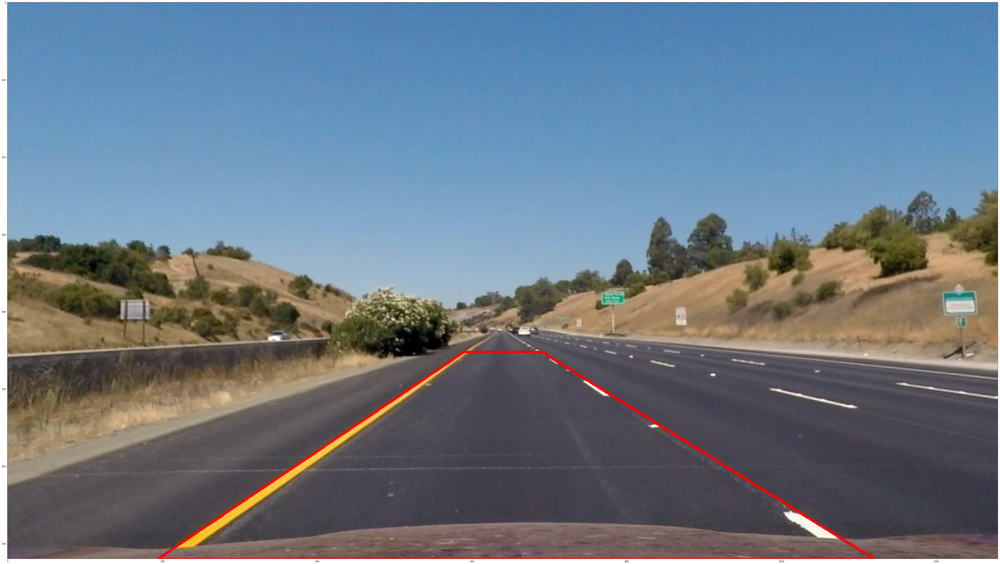

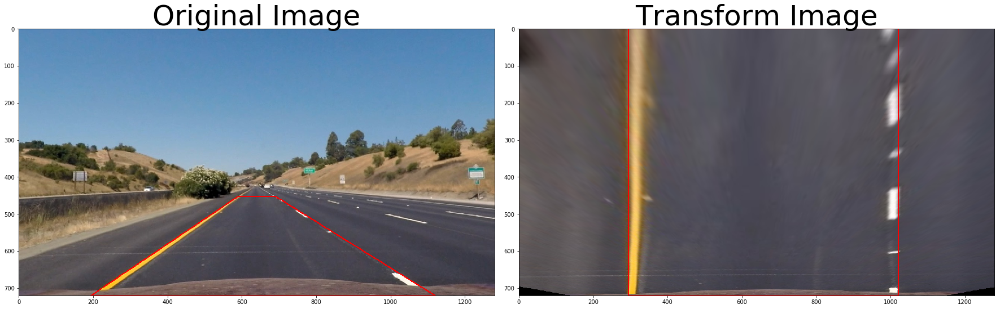

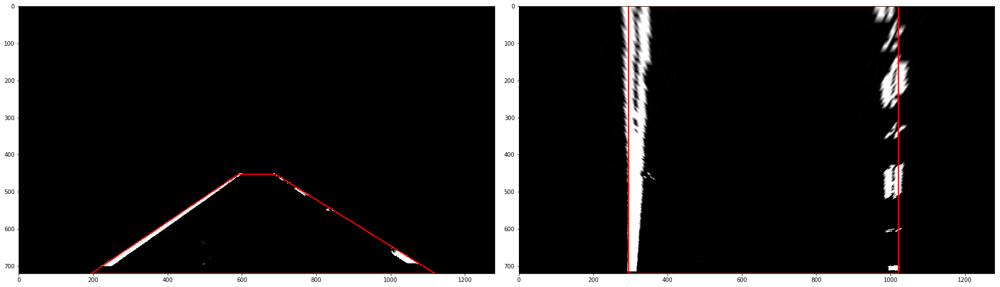

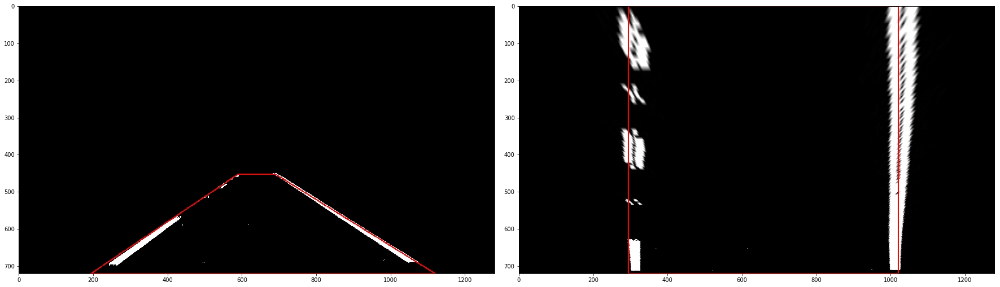

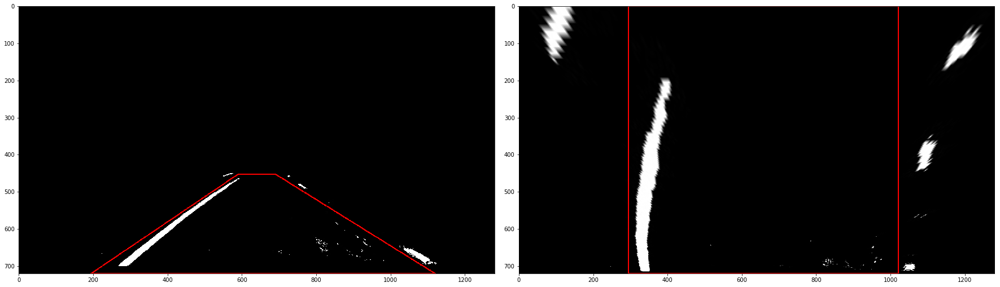

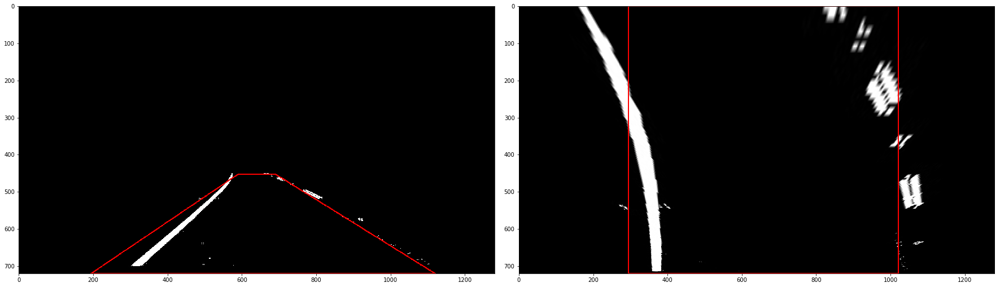

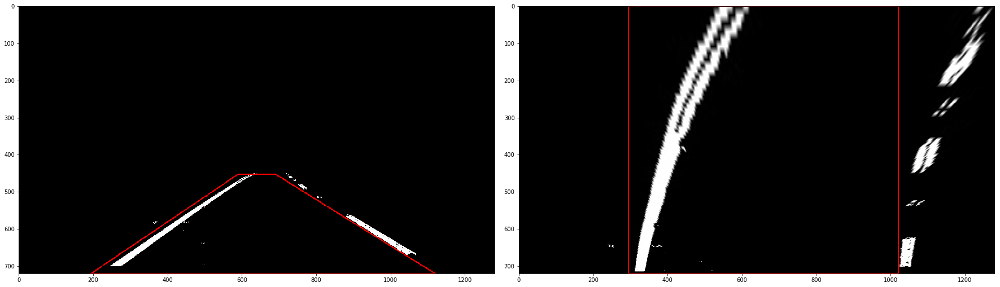

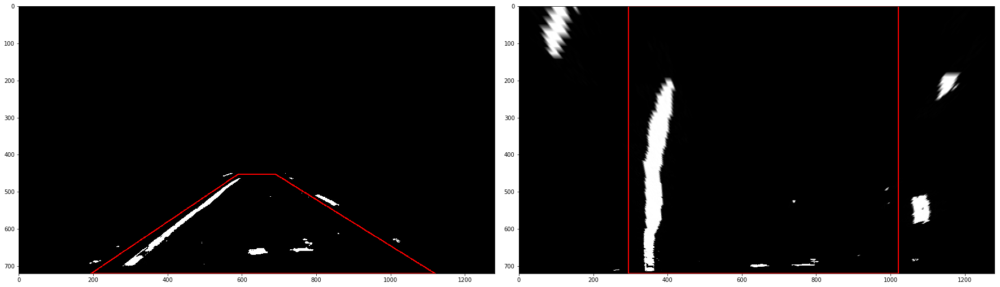

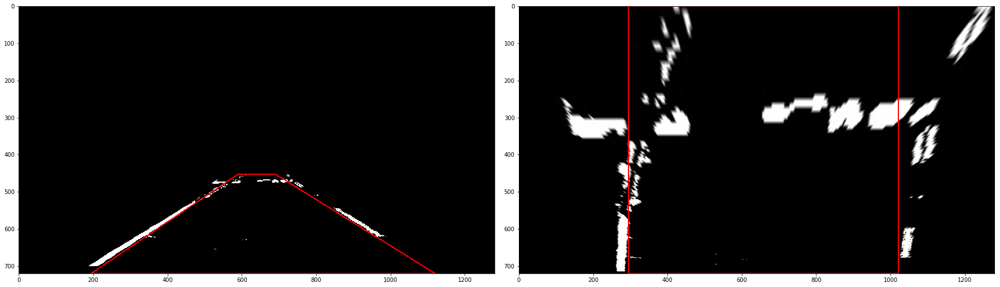

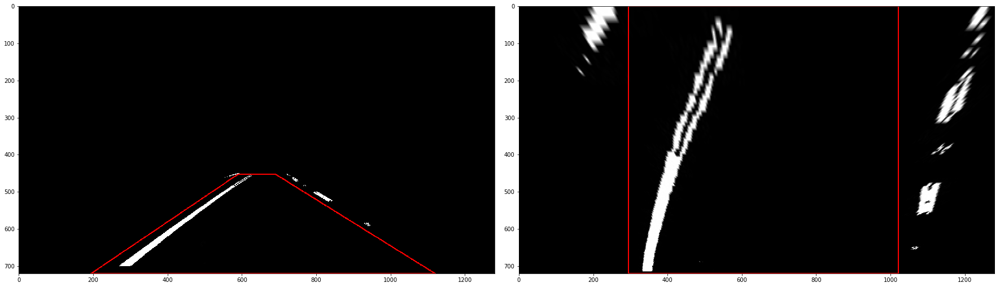

In [240]:
src_vertices = np.float32([
        [590, 452],
        [690, 452], 
        [1120, 720], 
        [194, 720]
    ])

dst_vertices = np.float32([
        [294, 0],
        [1020, 0], 
        [1020, 720], 
        [294, 720]
    ])

M = cv2.getPerspectiveTransform(src_vertices, dst_vertices)
Minv = cv2.getPerspectiveTransform(dst_vertices, src_vertices)

img = mpimg.imread(cor_images[0])
img_size = img.shape[1::-1]

warped = cv2.warpPerspective(img, M, img_size, flags=cv2.INTER_LINEAR)

draw_vertices(img, src_vertices, thickness=2)
draw_vertices(warped, dst_vertices, thickness=2)

# plot
fig = plt.figure(figsize=(80, 80))
fig.add_subplot(111)
plt.imshow(img)

f, (ax1, ax2) = plt.subplots(1, 2, figsize=(24, 9))
f.tight_layout()
ax1.imshow(img)
ax1.set_title('Original Image', fontsize=50)
ax2.imshow(warped)
ax2.set_title('Transform Image', fontsize=50)
plt.subplots_adjust(left=0., right=1, top=0.9, bottom=0.)


bin_images = glob.glob('output_images/binary_*.jpg')
bin_images.sort()
no_of_images = len(bin_images)

for i in range(no_of_images):
#for i in [0]:
    img = mpimg.imread(bin_images[i])
    warped = cv2.warpPerspective(img, M, img_size, flags=cv2.INTER_LINEAR)
    
    fname = bin_images[i].replace('binary_', 'warped_');
    cv2.imwrite(fname, warped)
    
    draw_vertices(img, src_vertices, thickness=2)
    draw_vertices(warped, dst_vertices, thickness=2)
    
    # plot
    f, (ax1, ax2) = plt.subplots(1, 2, figsize=(24, 9))
    f.tight_layout()
    ax1.imshow(img)
    ax2.imshow(warped)
    plt.subplots_adjust(left=0., right=1, top=0.9, bottom=0.)



## Detect lane pixels and fit to find the lane boundary


### Finding the Lines: Sliding Window

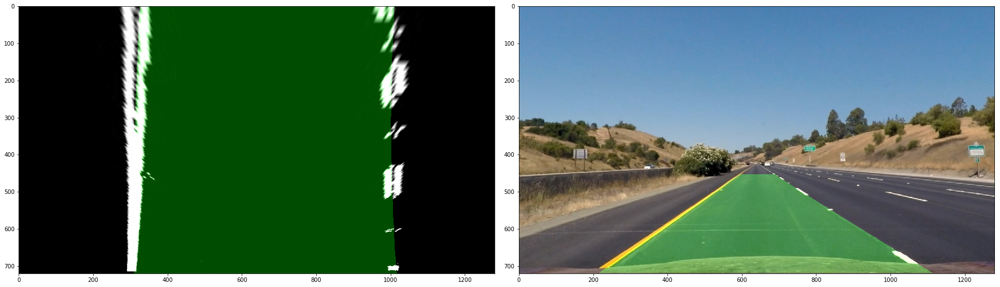

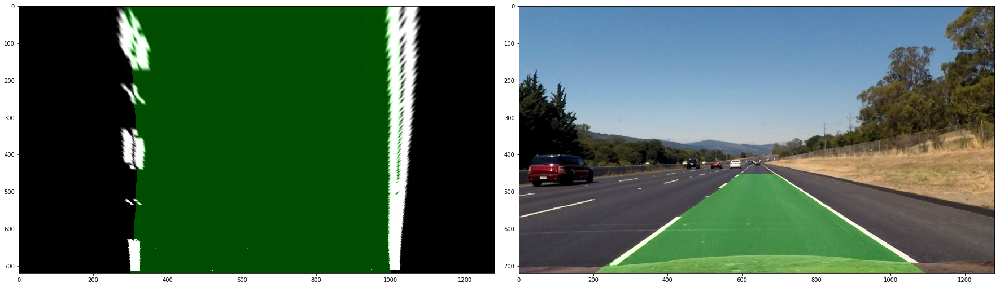

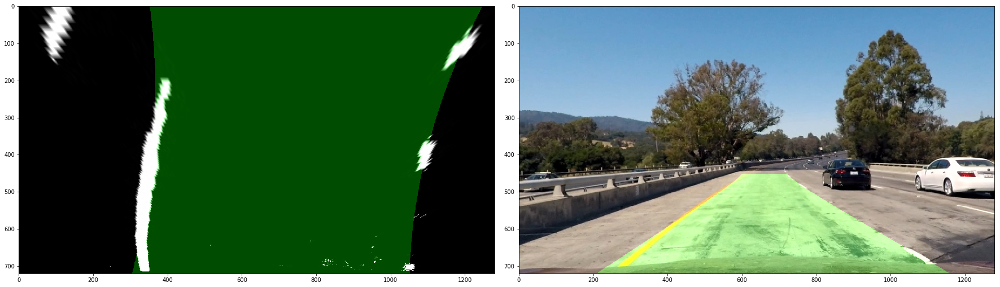

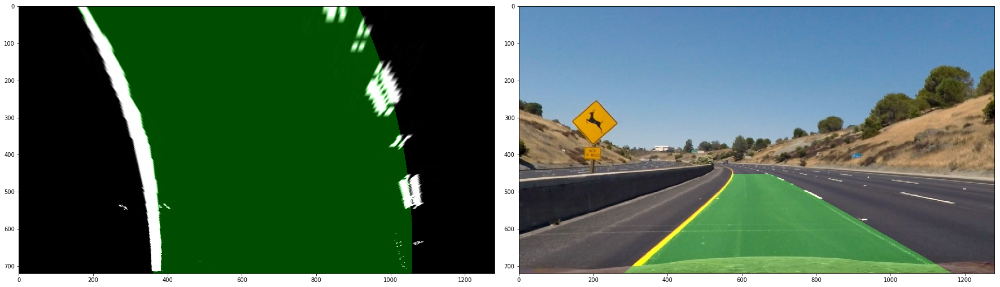

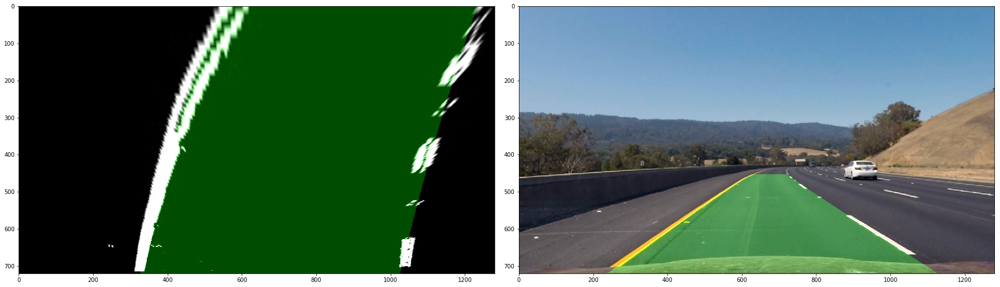

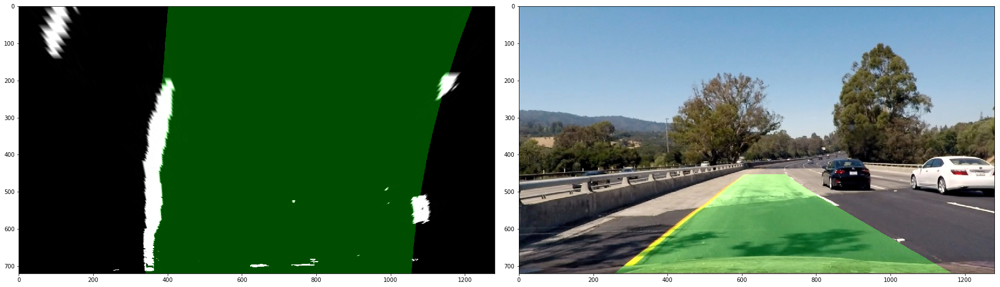

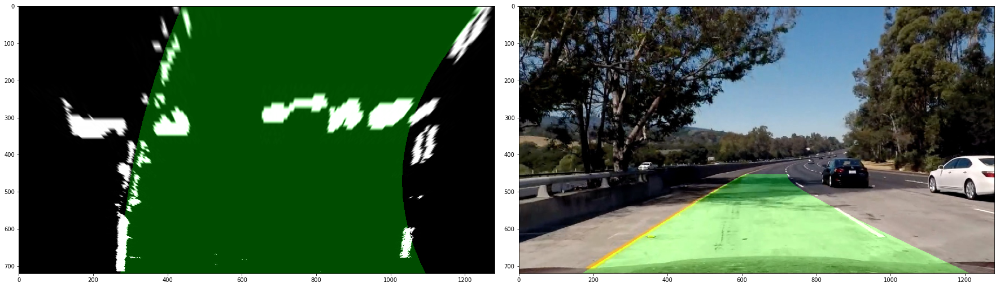

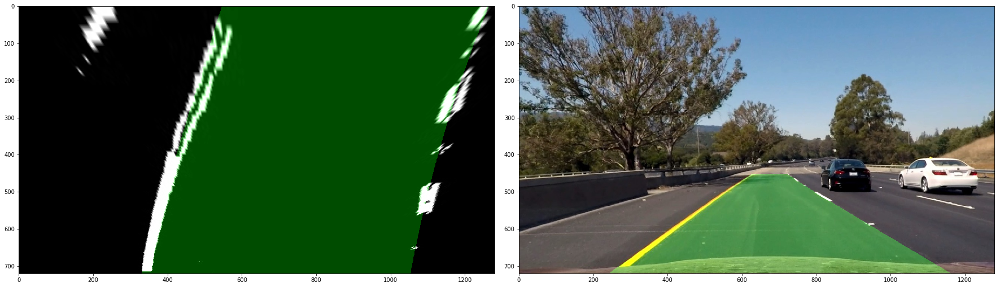

In [258]:
class Line():
    def __init__(self):
        # was the line detected in the last iteration?
        self.detected = False  
        # x values of the last n fits of the line
        self.recent_xfitted = [] 
        #average x values of the fitted line over the last n iterations
        self.bestx = None     
        #polynomial coefficients averaged over the last n iterations
        self.best_fit = None  
        #polynomial coefficients for the most recent fit
        self.current_fit = [np.array([False])]  
        #radius of curvature of the line in some units
        self.radius_of_curvature = None 
        #distance in meters of vehicle center from the line
        self.line_base_pos = None 
        #difference in fit coefficients between last and new fits
        self.diffs = np.array([0,0,0], dtype='float') 
        #x values for detected line pixels
        self.allx = None  
        #y values for detected line pixels
        self.ally = None  
        
    def fitXY(self, shape):
        # Generate x and y values for plotting
        ploty = np.linspace(0, shape[0]-1, shape[0] )
        try:
            fitx = self.best_fit[0]*ploty**2 + self.best_fit[1]*ploty + self.best_fit[2]
        except TypeError:
            # Avoids an error if `left` and `right_fit` are still none or incorrect
            print('The function failed to fit a line!')
            fitx = 1*ploty**2 + 1*ploty
            
        return fitx, ploty
    
    
def find_lane_pixels(binary_warped):
    # Take a histogram of the bottom half of the image
    histogram = np.sum(binary_warped[binary_warped.shape[0]//2:,:], axis=0)

    # Find the peak of the left and right halves of the histogram
    # These will be the starting point for the left and right lines
    midpoint = np.int(histogram.shape[0]//2)
    leftx_base = np.argmax(histogram[:midpoint])
    rightx_base = np.argmax(histogram[midpoint:]) + midpoint

    # HYPERPARAMETERS
    # Choose the number of sliding windows
    nwindows = 9
    # Set the width of the windows +/- margin
    margin = 100
    # Set minimum number of pixels found to recenter window
    minpix = 60

    # Set height of windows - based on nwindows above and image shape
    window_height = np.int(binary_warped.shape[0]//nwindows)
    # Identify the x and y positions of all nonzero pixels in the image
    nonzero = binary_warped.nonzero()
    nonzeroy = np.array(nonzero[0])
    nonzerox = np.array(nonzero[1])
    # Current positions to be updated later for each window in nwindows
    leftx_current = leftx_base
    rightx_current = rightx_base

    # Create empty lists to receive left and right lane pixel indices
    left_lane_inds = []
    right_lane_inds = []

    # Step through the windows one by one
    for window in range(nwindows):
        # Identify window boundaries in x and y (and right and left)
        win_y_low = binary_warped.shape[0] - (window+1)*window_height
        win_y_high = binary_warped.shape[0] - window*window_height
        ### TO-DO: Find the four below boundaries of the window ###
        win_xleft_low = leftx_current - margin  # Update this
        win_xleft_high = leftx_current + margin  # Update this
        win_xright_low = rightx_current - margin  # Update this
        win_xright_high = rightx_current + margin  # Update this
        
        
        ### TO-DO: Identify the nonzero pixels in x and y within the window ###
        good_left_inds = ((nonzeroy >= win_y_low) & (nonzeroy < win_y_high) & 
        (nonzerox >= win_xleft_low) &  (nonzerox < win_xleft_high)).nonzero()[0]
        good_right_inds = ((nonzeroy >= win_y_low) & (nonzeroy < win_y_high) & 
        (nonzerox >= win_xright_low) &  (nonzerox < win_xright_high)).nonzero()[0]
        
        # Append these indices to the lists
        left_lane_inds.append(good_left_inds)
        right_lane_inds.append(good_right_inds)
        
        if len(good_left_inds) > minpix:
            leftx_current = np.int(np.mean(nonzerox[good_left_inds]))
            
        if len(good_right_inds) > minpix:
            rightx_current = np.int(np.mean(nonzerox[good_right_inds]))

    # Concatenate the arrays of indices (previously was a list of lists of pixels)
    try:
        left_lane_inds = np.concatenate(left_lane_inds)
        right_lane_inds = np.concatenate(right_lane_inds)
    except ValueError:
        # Avoids an error if the above is not implemented fully
        pass

    # Extract left and right line pixel positions
    leftx = nonzerox[left_lane_inds]
    lefty = nonzeroy[left_lane_inds] 
    rightx = nonzerox[right_lane_inds]
    righty = nonzeroy[right_lane_inds]

    return leftx, lefty, rightx, righty


def fit_polynomial(binary_warped):
    # Find our lane pixels first
    leftx, lefty, rightx, righty = find_lane_pixels(binary_warped)
    
    ### TO-DO: Fit a second order polynomial to each using `np.polyfit` ###
    left_fit = np.polyfit(lefty, leftx, 2)
    right_fit = np.polyfit(righty, rightx, 2)

    return leftx, lefty, left_fit, rightx, righty, right_fit

def fitSlidingWindow(binary_warped):
    leftx, lefty, left_fit, rightx, righty, right_fit = fit_polynomial(binary_warped)
    
    leftLane = Line()
    leftLane.allx = leftx
    leftLane.ally = lefty
    leftLane.current_fit = left_fit
    leftLane.best_fit = left_fit
    
    rightLane = Line()
    rightLane.allx = rightx
    rightLane.ally = righty
    rightLane.current_fit = right_fit
    rightLane.best_fit = right_fit

    return leftLane, rightLane

def drawLane(image, warped, Minv, leftLane, rightLane):
    
    left_fitx, left_ploty = leftLane.fitXY(warped.shape)
    right_fitx, right_ploty = rightLane.fitXY(warped.shape)
    
    # Create an image to draw the lines on
    warp_zero = np.zeros_like(warped).astype(np.uint8)
    color_warp = np.dstack((warp_zero, warp_zero, warp_zero))

    # Recast the x and y points into usable format for cv2.fillPoly()
    pts_left = np.array([np.transpose(np.vstack([left_fitx, left_ploty]))])
    pts_right = np.array([np.flipud(np.transpose(np.vstack([right_fitx, right_ploty])))])
    pts = np.hstack((pts_left, pts_right))

    # Draw the lane onto the warped blank image
    cv2.fillPoly(color_warp, np.int_([pts]), (0,255, 0))
    
    newwarp = np.dstack((warped, warped, warped))
    lane_warped = cv2.addWeighted(newwarp, 1, color_warp, 0.3, 0)
    
    # Warp the blank back to original image space using inverse perspective matrix (Minv)
    newwarp = cv2.warpPerspective(color_warp, Minv, (image.shape[1], image.shape[0])) 
    # Combine the result with the original image
    
    lane_image = cv2.addWeighted(image, 1, newwarp, 0.3, 0)
    
    return lane_image, lane_warped

    
warped_images = glob.glob('output_images/warped_*.jpg')
warped_images.sort()
no_of_images = len(warped_images)

sliding_lanes = []

for i in range(no_of_images):
#for i in [0]:
    img = mpimg.imread(warped_images[i])
    gray = cv2.cvtColor(img, cv2.COLOR_RGB2GRAY)

    leftLane, rightLane = fitSlidingWindow(gray)
    sliding_lanes.append((leftLane, rightLane))
    
    cor_image = mpimg.imread(cor_images[i])
    lane_image, lane_warped = drawLane(cor_image, gray, Minv, leftLane, rightLane)
    
    # plot
    f, (ax1, ax2) = plt.subplots(1, 2, figsize=(24, 9))
    f.tight_layout()
    ax1.imshow(lane_warped)
    ax2.imshow(lane_image)
    plt.subplots_adjust(left=0., right=1, top=0.9, bottom=0.)
    


### Finding the Lines: Search from Prior

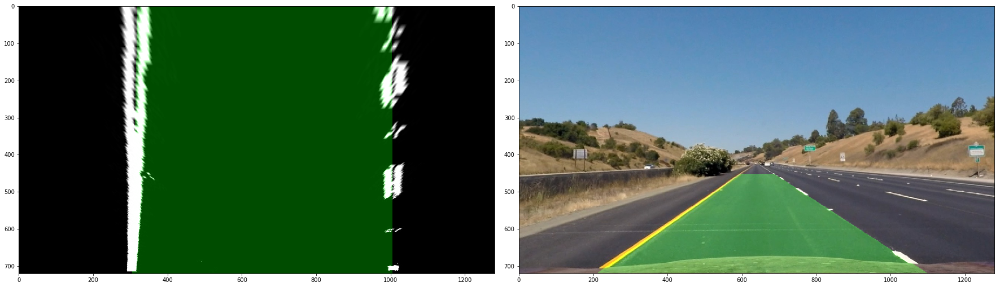

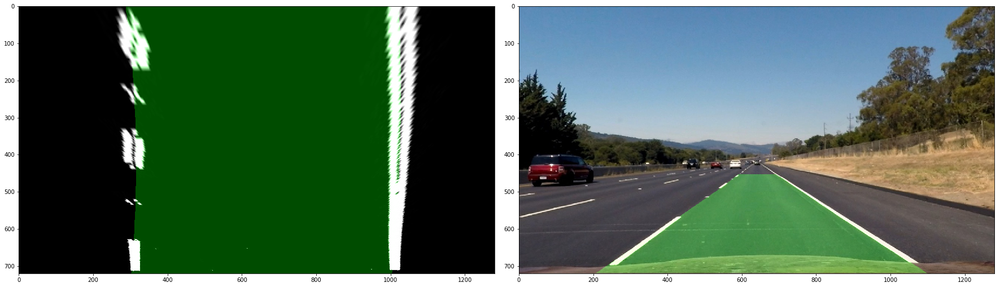

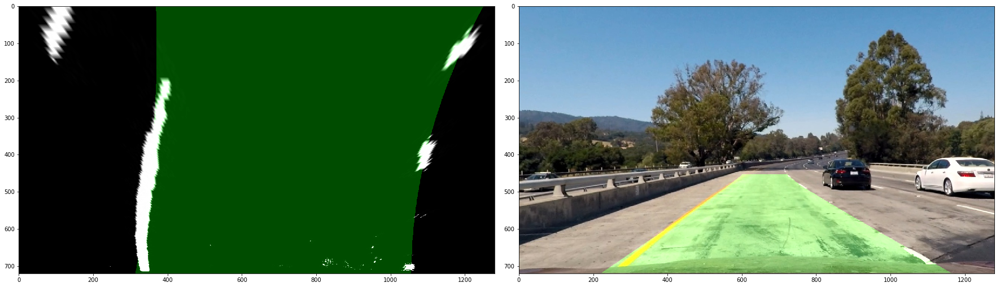

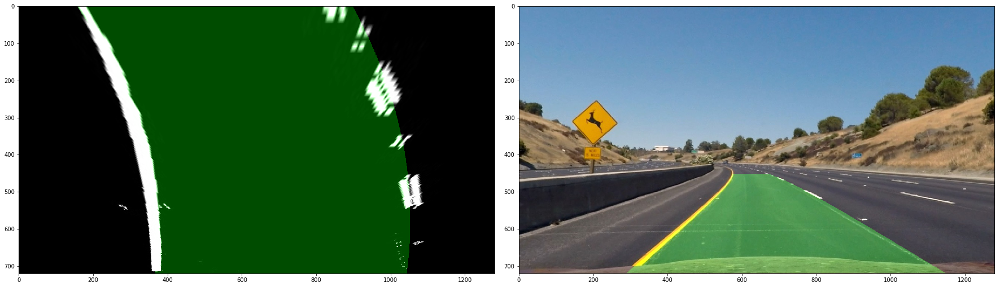

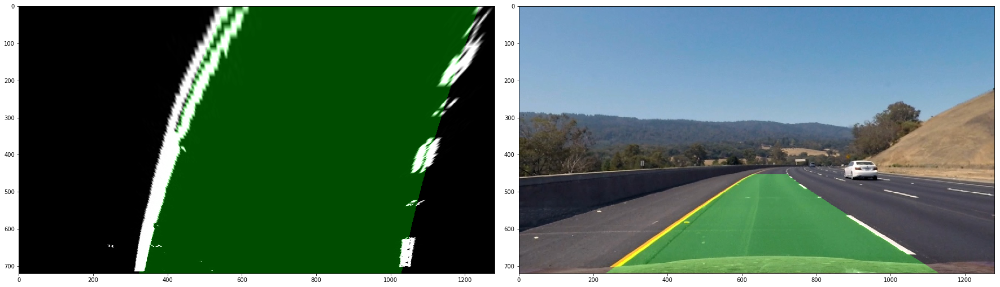

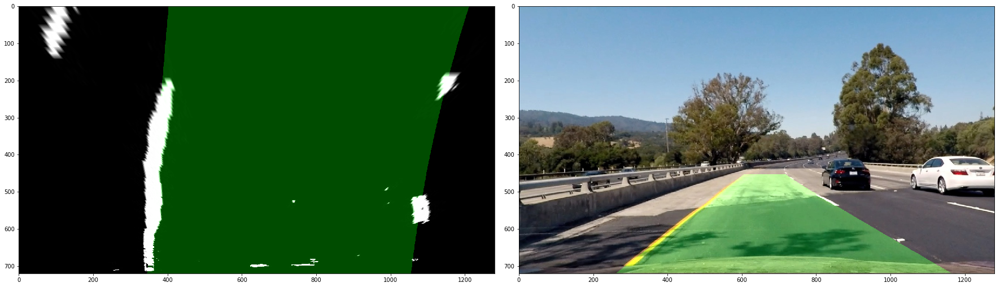

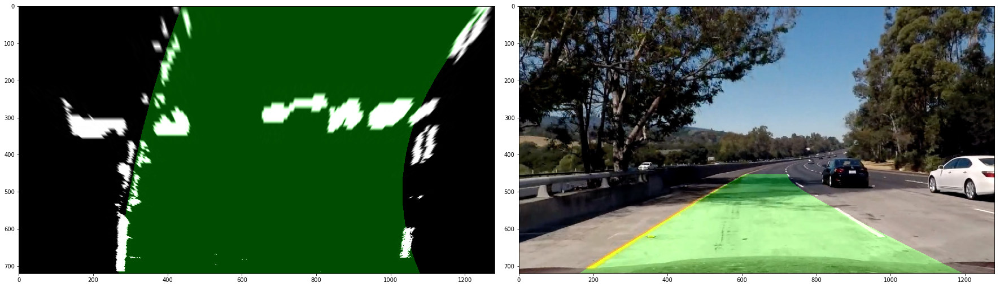

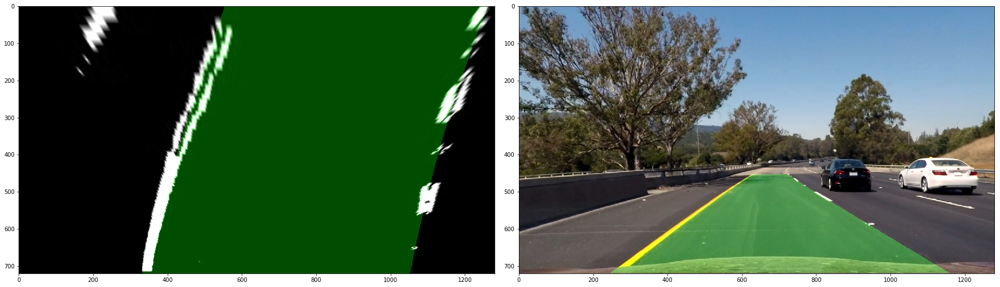

In [259]:
def search_around_poly(binary_warped, left_fit, right_fit):
    # HYPERPARAMETER
    # Choose the width of the margin around the previous polynomial to search
    margin = 50

    # Grab activated pixels
    nonzero = binary_warped.nonzero()
    nonzeroy = np.array(nonzero[0])
    nonzerox = np.array(nonzero[1])
    
    left_lane_inds = ((nonzerox > (left_fit[0]*(nonzeroy**2) + left_fit[1]*nonzeroy + 
                    left_fit[2] - margin)) & (nonzerox < (left_fit[0]*(nonzeroy**2) + 
                    left_fit[1]*nonzeroy + left_fit[2] + margin)))
    right_lane_inds = ((nonzerox > (right_fit[0]*(nonzeroy**2) + right_fit[1]*nonzeroy + 
                    right_fit[2] - margin)) & (nonzerox < (right_fit[0]*(nonzeroy**2) + 
                    right_fit[1]*nonzeroy + right_fit[2] + margin)))
    
    # Again, extract left and right line pixel positions
    leftx = nonzerox[left_lane_inds]
    lefty = nonzeroy[left_lane_inds] 
    rightx = nonzerox[right_lane_inds]
    righty = nonzeroy[right_lane_inds]

    # Fit new polynomials
    left_fit = np.polyfit(lefty, leftx, 2)
    right_fit = np.polyfit(righty, rightx, 2)
    
    return leftx, lefty, left_fit, rightx, righty, right_fit

def fitAroundPoly(binary_warped, leftLane, rightLane):
    leftx, lefty, left_fit, rightx, righty, right_fit = search_around_poly(
        binary_warped, 
        leftLane.best_fit, 
        rightLane.best_fit
    )
    
    leftLane = Line()
    leftLane.allx = leftx
    leftLane.ally = lefty
    leftLane.current_fit = left_fit
    leftLane.best_fit = left_fit
    
    rightLane = Line()
    rightLane.allx = rightx
    rightLane.ally = righty
    rightLane.current_fit = right_fit
    rightLane.best_fit = right_fit

    return leftLane, rightLane

prior_lanes = []

for i in range(no_of_images):
#for i in [0]:
    img = mpimg.imread(warped_images[i])
    gray = cv2.cvtColor(img, cv2.COLOR_RGB2GRAY)

    leftOldLane, rightOldLane = sliding_lanes[i]
    leftLane, rightLane = fitAroundPoly(gray, leftOldLane, rightOldLane)
    prior_lanes.append((leftLane, rightLane))

    cor_image = mpimg.imread(cor_images[i])
    lane_image, lane_warped = drawLane(cor_image, gray, Minv, leftLane, rightLane)
    
    # plot
    f, (ax1, ax2) = plt.subplots(1, 2, figsize=(24, 9))
    f.tight_layout()
    ax1.imshow(lane_warped)
    ax2.imshow(lane_image)
    plt.subplots_adjust(left=0., right=1, top=0.9, bottom=0.)

## Determine the curvature of the lane and vehicle position with respect to center